<center>
<img src="./pict/librosa_logo.png">
<br />
<br />

# Introduction to audio processing 

In [1]:
import numpy as np

import scipy
from scipy.io import wavfile

import librosa # pip install librosa / conda install -c conda-forge librosa

import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
import IPython.display as ipd

ipd.Audio('./data/wwry.wav')

Аудио представляется дискретно

<center>
<img src="./pict/sound_wave_array.png">
<br />
<br />

In [3]:
samplerate, wavedata = wavfile.read('./data/wwry.wav') # считываем данные (scipy)

In [4]:
wavedata # (ненормированное) значение амплитуды волны

array([[    0,     0],
       [    0,     0],
       [    0,     0],
       ...,
       [-2151, -3924],
       [-2520, -3616],
       [-2712, -2999]], dtype=int16)

In [5]:
samplerate # стандартная частота дискретизации - 44100 Hz, сколько сэмплов (срезов данных) в секунде

44100

In [6]:
type(wavedata) # знакомый нам numpy - массив

numpy.ndarray

In [7]:
wavedata.shape # 2 размерности (2 канала) - стерео звук

(1543500, 2)

In [8]:
wavedata.shape[0] # количество сэмплов

1543500

In [9]:
int(wavedata.shape[0] / samplerate) # время записи в секундах, 35 секунд

35

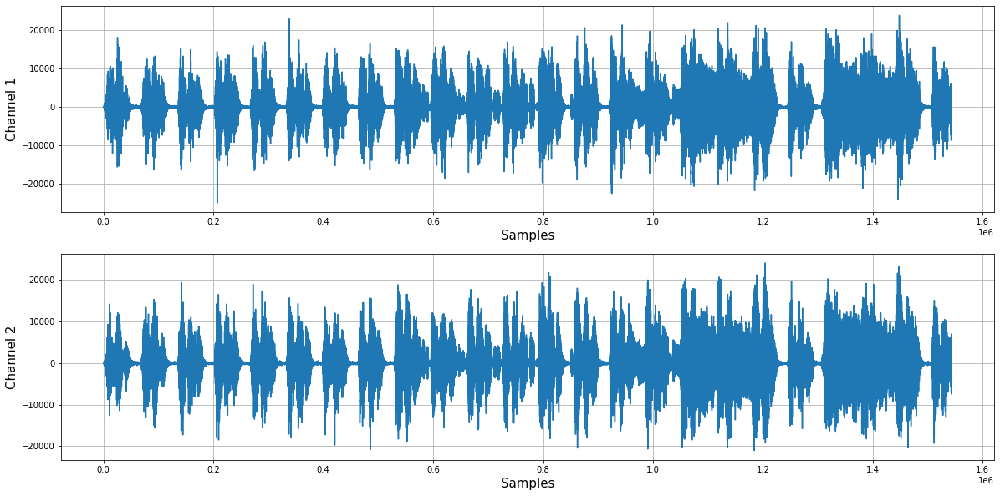

In [10]:
# waveform график 

plt.figure(figsize=(20, 10))
plt.subplot(2, 1, 1)
plt.plot(wavedata[:, 0])
plt.ylabel('Channel 1', fontsize=15)
plt.xlabel('Samples', fontsize=15)
plt.grid(True)

plt.subplot(2, 1, 2)
plt.plot(wavedata[:, 1])
plt.ylabel('Channel 2', fontsize=15)
plt.xlabel('Samples', fontsize=15)
plt.grid(True)
plt.show()

In [11]:
wavedata_mono = wavedata.mean(axis=1) # конвертируем данные в моно-звук

In [12]:
# стандартная нормализация -> [-1, 1], из рассчета что амплитуда 16-битное число

wavedata_mono = wavedata_mono / 32768.0 

In [13]:
np.min(wavedata_mono), np.max(wavedata_mono)

(-0.5869598388671875, 0.58636474609375)

In [14]:
ipd.Audio(wavedata_mono[::-1], rate=samplerate) # можем развернуть или взять какой то аудио сегмент

In [15]:
# Создание своих wav файлов 

sr = 22050 # частота дискретизации
T = 5.0    # количество секунды
t = np.linspace(0, T, int(T * sr), endpoint=False) # переменная времени
x = 0.5 * np.sin(2 * np.pi * 220 * t) # чистая синусоидная волна при 220 Гц

ipd.Audio(x, rate=sr)

In [16]:
# считывание данных через Librosa

wavedata_librosa, samplerate = librosa.load('./data/wwry.wav', sr=samplerate, mono=True, duration=None)

# запись аудио
# librosa.output.write_wav('name_of_file.wav', wavedata_librosa, samplerate)

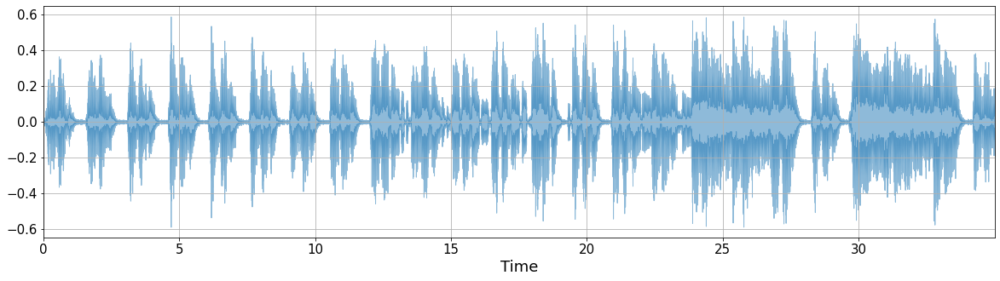

In [17]:
import librosa.display

plt.figure(figsize=(20, 5))
librosa.display.waveplot(wavedata_librosa, sr=samplerate, alpha=0.5) # waveplot Librosa

ax = plt.gca()
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15) 

plt.xlabel('Time', fontsize=18)

plt.grid(True) 
plt.show()

In [18]:
wavedata_librosa # моно звук с нормализацией

array([ 0.        ,  0.        ,  0.        , ..., -0.09269714,
       -0.09362793, -0.08714294], dtype=float32)

In [19]:
librosa.get_duration(wavedata_librosa, samplerate) # время записи в секундах через librosa

35.0

In [20]:
# определяем темп и бит

tempo, beat_frames = librosa.beat.beat_track(y=wavedata_librosa, sr=samplerate)

In [21]:
# https://en.wikipedia.org/wiki/Tempo

tempo # количество ударов (битов) в минуту

80.74951171875

In [22]:
beat_frames # окна в которых оцениваем функции от аудио-ряда

array([  16,   77,  141,  205,  269,  333,  398,  463,  525,  592,  655,
        719,  782,  845,  909,  973, 1038, 1101, 1167, 1231, 1295, 1358,
       1421, 1484, 1549, 1612, 1677, 1738, 1801, 1861, 1929, 1990, 2054,
       2118, 2183, 2246, 2309, 2374, 2436, 2499, 2563, 2631, 2696, 2758,
       2821, 2885, 2947])

In [23]:
# конвертируем фреймы в секунды (далее подробнее)

beat_times = librosa.frames_to_time(beat_frames, sr=samplerate) # times[i] = frames[i] * hop_length / sr
beat_times

array([ 0.18575964,  0.89396825,  1.6370068 ,  2.38004535,  3.1230839 ,
        3.86612245,  4.62077098,  5.3754195 ,  6.0952381 ,  6.87310658,
        7.60453515,  8.3475737 ,  9.07900227,  9.81043084, 10.55346939,
       11.29650794, 12.05115646, 12.78258503, 13.54884354, 14.29188209,
       15.03492063, 15.76634921, 16.49777778, 17.22920635, 17.98385488,
       18.71528345, 19.46993197, 20.17814059, 20.90956916, 21.6061678 ,
       22.39564626, 23.10385488, 23.84689342, 24.58993197, 25.3445805 ,
       26.07600907, 26.80743764, 27.56208617, 28.28190476, 29.01333333,
       29.75637188, 30.54585034, 31.30049887, 32.02031746, 32.75174603,
       33.49478458, 34.21460317])

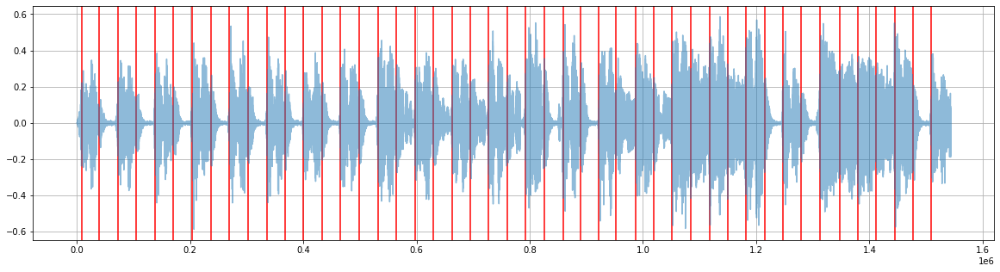

In [24]:
plt.figure(figsize=(20, 5))

for x in librosa.frames_to_samples(beat_frames):
    plt.axvline(x=x, color='red', linewidth=1.5)
    
plt.plot(wavedata_librosa, alpha=0.5)
plt.grid(True)
plt.show()

Разбиение звуковой дорожки на фреймы

In [25]:
x = np.array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]) 

librosa.util.frame(x, frame_length=3, hop_length=2, axis=-1) # фреймы могут перекрываться

array([[0, 2, 4, 6],
       [1, 3, 5, 7],
       [2, 4, 6, 8]])

In [26]:
# а могут не перекрываться

librosa.util.frame(x, frame_length=3, hop_length=2, axis=0)

array([[0, 1, 2],
       [2, 3, 4],
       [4, 5, 6],
       [6, 7, 8]])

In [27]:
# разбиваем аудио-дорожку на фреймы-секунды

frames = librosa.util.frame(wavedata_librosa, frame_length=samplerate, hop_length=samplerate, axis=0)
frames.shape

(35, 44100)

In [28]:
frames

array([[ 0.        ,  0.        ,  0.        , ...,  0.01527405,
         0.0135498 ,  0.01280212],
       [ 0.01509094,  0.01751709,  0.01599121, ...,  0.02818298,
         0.02505493,  0.02102661],
       [ 0.01631165,  0.01235962,  0.0093689 , ..., -0.00238037,
        -0.00239563, -0.00244141],
       ...,
       [ 0.02680969,  0.03182983,  0.03132629, ...,  0.16352844,
         0.16500854,  0.16796875],
       [ 0.17021179,  0.16952515,  0.16513062, ..., -0.00454712,
        -0.00450134, -0.00479126],
       [-0.0050354 , -0.0052948 , -0.00561523, ..., -0.09269714,
        -0.09362793, -0.08714294]], dtype=float32)

Генерация признаков аудио-ряда

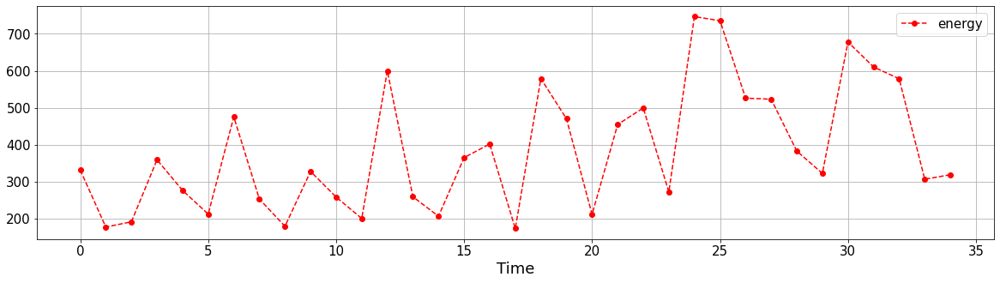

In [29]:
# Энергия сигнала

def energy(x):
    return np.sum((x ** 2)) # пропорциональна квадрату амплитуды

plt.figure(figsize=(20, 5)) # считаем для каждой секунды энергию волны
plt.plot([energy(frame) for frame in frames], '--o', color='red', label='energy')
plt.grid(True)
plt.legend(prop={'size':15})

ax = plt.gca()
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
    
plt.xlabel('Time', fontsize=18)
plt.show()

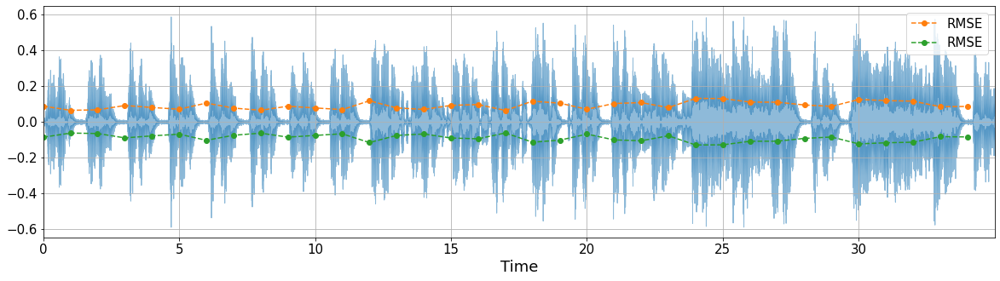

In [30]:
# RMS огибающие 

# RMS – параметр, показывающий среднюю громкость звучания трека или какой-либо его части. 
# С математической точки зрения RMS (Root Mean Square) 
#        - это среднеквадратическое значение громкостей всех семплов дорожки.

rmse = librosa.feature.rms(wavedata_librosa, frame_length=samplerate, hop_length=samplerate, center=False)

plt.figure(figsize=(20, 5))
librosa.display.waveplot(wavedata_librosa, sr=samplerate, alpha=0.5)
plt.plot(rmse[0], '--o', label='RMSE')
plt.plot(-rmse[0], '--o', label='RMSE')
plt.grid(True)
plt.legend(prop={'size':15})

ax = plt.gca()
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
    
plt.xlabel('Time', fontsize=18)
plt.show()

(10000,)


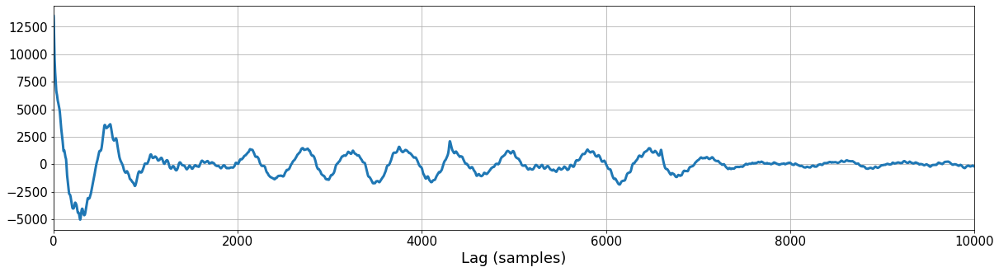

In [31]:
# автокорреляция - поиск повторяющихся паттернов 

r = librosa.autocorrelate(wavedata_librosa, max_size=10000) # указываем количество лагов в семлах
print(r.shape)

plt.figure(figsize=(20, 5))
plt.plot(r, lw=3)
plt.xlim(0, 10000)

ax = plt.gca()
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15) 

plt.xlabel('Lag (samples)', fontsize=18)
plt.grid(True)
plt.show()

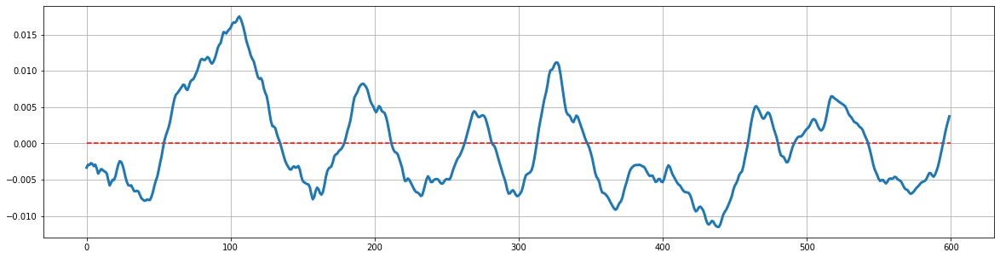

In [32]:
# еще одна важная характеристика - скорость перехода через 0

plt.figure(figsize=(20, 5))
plt.plot(wavedata_librosa[1400:2000], lw=3)
plt.hlines(y=0, xmin=0, xmax=600, color='red', ls='--')
plt.grid(True)
plt.show()

In [33]:
zero_crossings = librosa.zero_crossings(wavedata_librosa[1400:2000], pad=False)
zero_crossings[:60] # соответствующая маска

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
        True, False, False, False, False, False])

In [34]:
zero_crossings.sum() # количество переходов

13

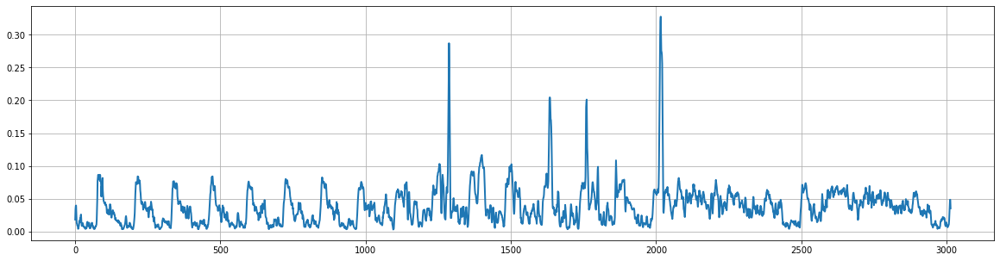

In [35]:
# https://en.wikipedia.org/wiki/Zero-crossing_rate
# скорость перехода через 0
    
plt.figure(figsize=(20, 5))
plt.plot(librosa.feature.zero_crossing_rate(wavedata_librosa)[0], lw=2)
plt.grid(True)
plt.show()

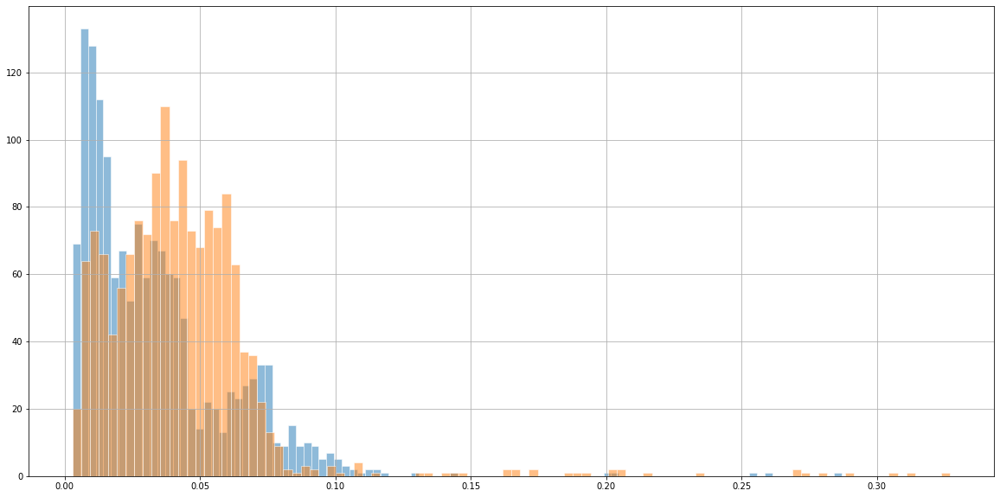

In [36]:
# значимый признак для классификационных задач

zcr1 = librosa.feature.zero_crossing_rate(wavedata_librosa[:771750]) 
zcr2 = librosa.feature.zero_crossing_rate(wavedata_librosa[771750:])

plt.figure(figsize=(20, 10))
plt.hist(zcr1[0], bins=100, alpha=0.5,  edgecolor='white')
plt.hist(zcr2[0], bins=100, alpha=0.5, edgecolor='white')
plt.grid(True)
plt.show()

Спектральные признаки

<center>
<img src="./pict/spectr.png">
<br />
<br />

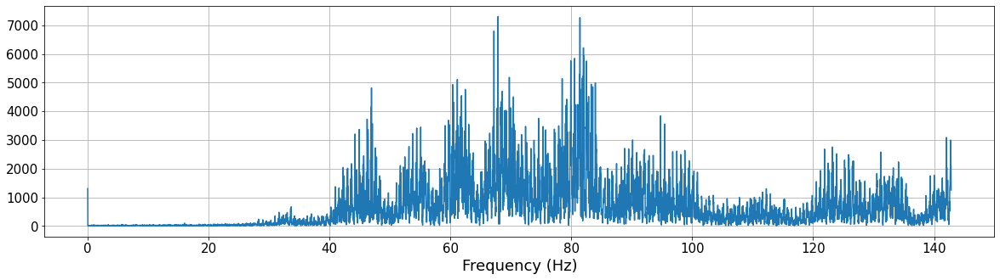

In [37]:
# Фурье спектр

fft = scipy.fft(wavedata_librosa) # считаем спектр
fft_mag = np.absolute(fft) # приводим к абсолютным значениям
f = np.linspace(0, samplerate, len(fft_mag))

plt.figure(figsize=(20, 5))
plt.plot(f[:5000], fft_mag[:5000]) # выводим только первые 5000 компонент спектра

ax = plt.gca()
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15) 

plt.grid(True)
plt.xlabel('Frequency (Hz)', fontsize=18)
plt.show()

In [38]:
# Оконное преобразование Фурье
# https://en.wikipedia.org/wiki/Short-time_Fourier_transform

hop_length = 512
n_fft = 2048

stft = librosa.stft(wavedata_librosa, n_fft=n_fft, hop_length=hop_length)
stft.shape # axis 1: 3015 - фреймов, len(wavedata_librosa) / hop_lenght; 
            # axis 0: (1 + n_fft/2) из свойств преобразования

(1025, 3015)

/Users/aleksey_ryabykh/anaconda3/lib/python3.6/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'basey' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
/Users/aleksey_ryabykh/anaconda3/lib/python3.6/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'linthreshy' parameter of __init__() has been renamed 'linthresh' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
/Users/aleksey_ryabykh/anaconda3/lib/python3.6/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'linscaley' parameter of __init__() has been renamed 'linscale' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)


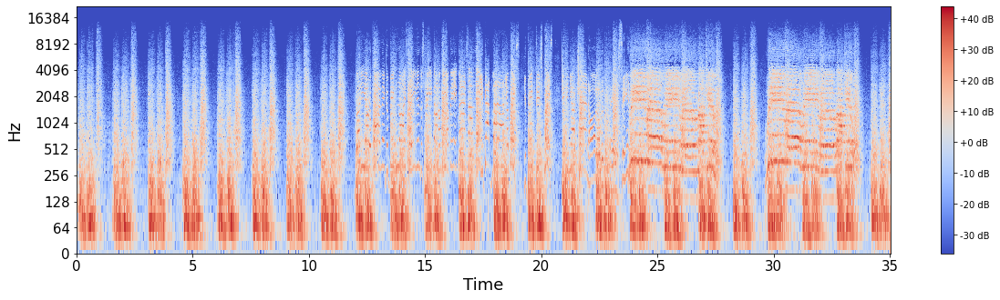

In [39]:
# спектрограмма
S = librosa.amplitude_to_db(np.abs(stft)) # логарифм амлитуды 

plt.figure(figsize=(20, 5))
librosa.display.specshow(S, sr=samplerate, hop_length=hop_length, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')

ax = plt.gca()
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15) 

plt.ylabel('Hz', fontsize=18)
plt.xlabel('Time', fontsize=18)
plt.show()

<center>
<img src="./pict/harmonic_percussive.png">
<br />
<br />

In [40]:
# http://mir.ilsp.gr/harmonic_percussive_separation.html
# гармонические составляющие -> горизонтальные линии на спектрограмме
# ударные составляющие -> вертикальные линии

wavedata_harmonic, wavedata_percussive = librosa.effects.hpss(wavedata_librosa)

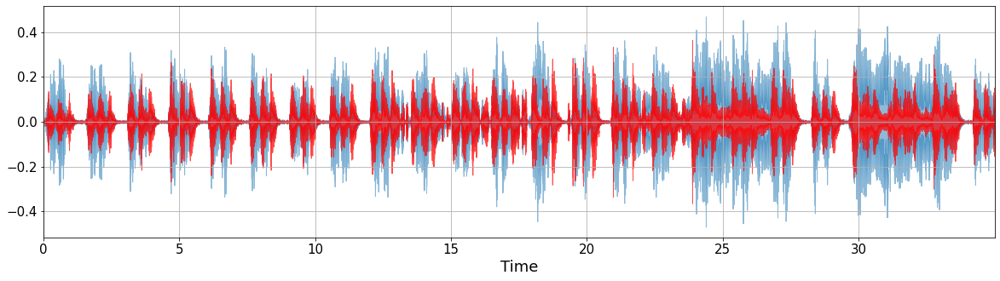

In [41]:
plt.figure(figsize=(20, 5))

librosa.display.waveplot(wavedata_harmonic, sr=samplerate, alpha=0.5)
librosa.display.waveplot(wavedata_percussive, sr=samplerate, color='r', alpha=0.7)

ax = plt.gca()
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15) 

plt.xlabel('Time', fontsize=18)

plt.grid(True) 
plt.show()

In [42]:
ipd.Audio(wavedata_harmonic, rate=samplerate)

In [43]:
ipd.Audio(wavedata_percussive, rate=samplerate)

In [44]:
# Спектральный центроид
# https://en.wikipedia.org/wiki/Spectral_centroid

spectral_centroids = librosa.feature.spectral_centroid(wavedata_librosa, sr=samplerate)[0]
spectral_centroids # свой для каждого окна

array([5653.90015694, 3234.49671025, 2158.38111624, ..., 2025.60241223,
       2101.41970247, 1991.8260873 ])

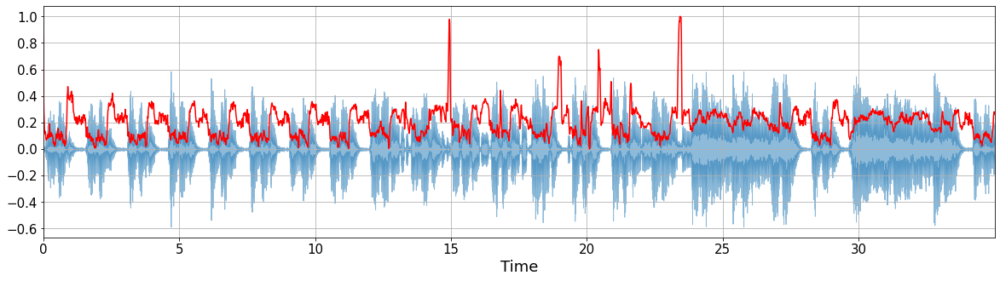

In [45]:
import sklearn

frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames, sr=samplerate, 
                           hop_length=hop_length) # times[i] = frames[i] * hop_length / sr

def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

plt.figure(figsize=(20, 5))
librosa.display.waveplot(wavedata_librosa, sr=samplerate, alpha=0.5)
plt.plot(t, normalize(spectral_centroids), color='r')
plt.grid(True)

ax = plt.gca()
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
    
plt.xlabel('Time', fontsize=18)
plt.show()

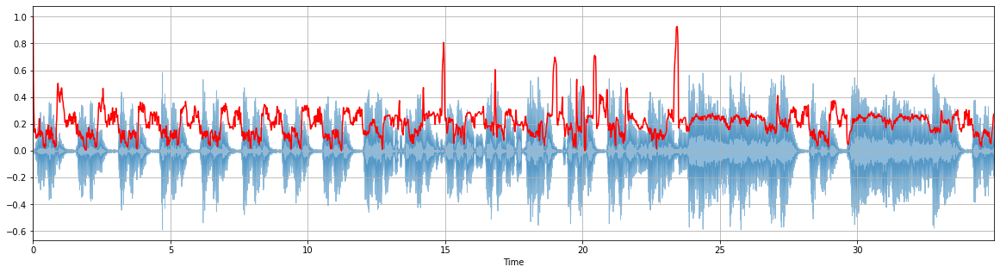

In [46]:
# Спектральный спад
# Определяется как относительная частота, 
# в пределах которой которой сосредоточена определенная часть всей энергии спектра 
# (задается в качестве параметра с)

spectral_rolloff = librosa.feature.spectral_rolloff(wavedata_librosa, sr=samplerate)[0]

plt.figure(figsize=(20, 5))
librosa.display.waveplot(wavedata_librosa, sr=samplerate, alpha=0.5)
plt.plot(t, normalize(spectral_rolloff), color='r')
plt.grid(True)
plt.show()

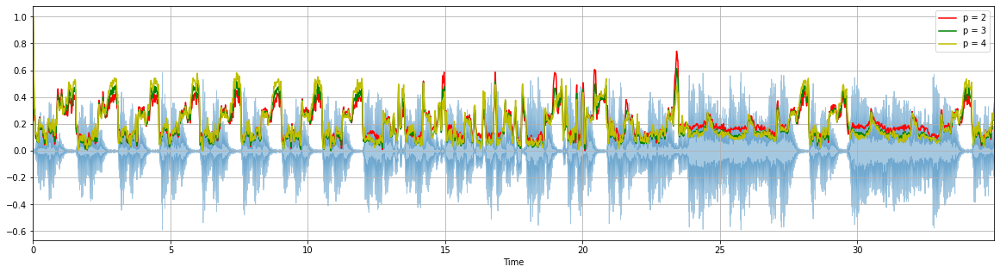

In [47]:
# Спектральная ширина

# Полоса спектра на пиках
# p - мощность отклонения от спектрального центроида

spectral_bandwidth_2 = librosa.feature.spectral_bandwidth(wavedata_librosa, sr=samplerate)[0] 
spectral_bandwidth_3 = librosa.feature.spectral_bandwidth(wavedata_librosa, sr=samplerate, p=3)[0]
spectral_bandwidth_4 = librosa.feature.spectral_bandwidth(wavedata_librosa, sr=samplerate, p=4)[0]

plt.figure(figsize=(20, 5))
librosa.display.waveplot(wavedata_librosa, sr=samplerate, alpha=0.4)
plt.plot(t, normalize(spectral_bandwidth_2), color='r')
plt.plot(t, normalize(spectral_bandwidth_3), color='g')
plt.plot(t, normalize(spectral_bandwidth_4), color='y')
plt.legend(('p = 2', 'p = 3', 'p = 4'))
plt.grid(True)
plt.show()

/Users/aleksey_ryabykh/anaconda3/lib/python3.6/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'basey' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
/Users/aleksey_ryabykh/anaconda3/lib/python3.6/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'linthreshy' parameter of __init__() has been renamed 'linthresh' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)


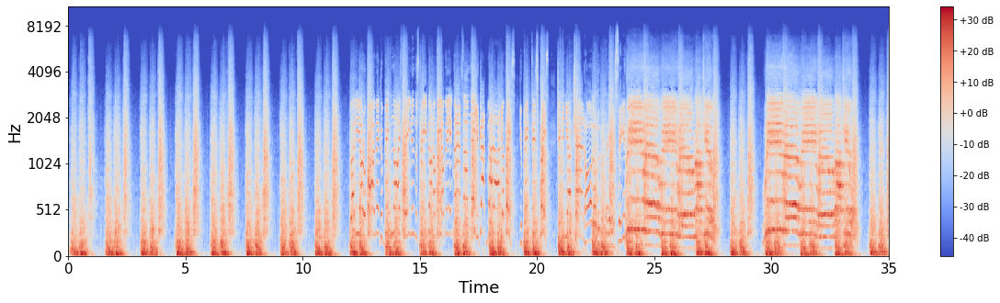

In [48]:
# Mel-spectrogram
# https://en.wikipedia.org/wiki/Mel-frequency_cepstrum

hop_length = 256
S = librosa.feature.melspectrogram(wavedata_librosa, sr=samplerate, n_fft=4096, hop_length=hop_length)
logS = librosa.power_to_db(abs(S))

plt.figure(figsize=(20, 5))
librosa.display.specshow(logS, sr=samplerate, hop_length=hop_length, x_axis='time', y_axis='mel')
plt.colorbar(format='%+2.0f dB')

ax = plt.gca()
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15) 

plt.ylabel('Hz', fontsize=18)
plt.xlabel('Time', fontsize=18)
plt.show()

/Users/aleksey_ryabykh/anaconda3/lib/python3.6/site-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/Users/aleksey_ryabykh/anaconda3/lib/python3.6/site-packages/scipy/sparse/lil.py:514: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not j.flags.writeable or j.dtype not in (np.int32, np.int64):
/Users/aleksey_ryabykh/anaconda3/lib/python3.6/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'basey' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)


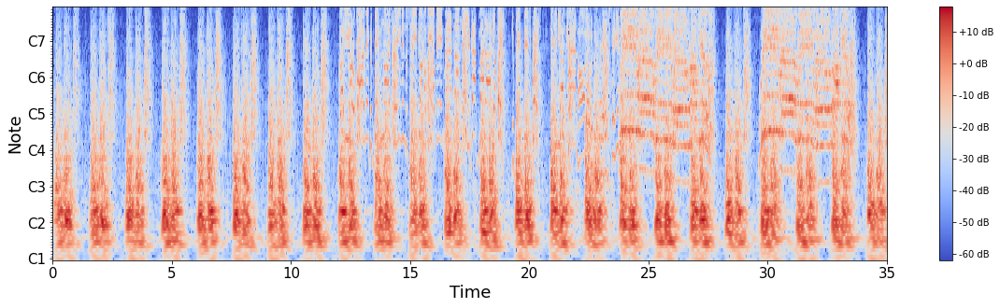

In [49]:
# https://en.wikipedia.org/wiki/Constant-Q_transform

C = librosa.cqt(wavedata_librosa, sr=samplerate)
logC = librosa.amplitude_to_db(abs(C))

plt.figure(figsize=(20, 5))
librosa.display.specshow(logC, sr=samplerate, x_axis='time', y_axis='cqt_note', cmap='coolwarm')
plt.colorbar(format='%+2.0f dB')

ax = plt.gca()
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15) 

plt.ylabel('Note', fontsize=18)
plt.xlabel('Time', fontsize=18)

plt.show()

In [50]:
ipd.Audio(wavedata_librosa[:441000], rate=samplerate) # 10 секунд

In [51]:
# onset detection
# предобученнный алгоритм на https://github.com/CPJKU/onset_db

onset_frames = librosa.onset.onset_detect(wavedata_librosa[:441000], sr=samplerate)
onset_frames

array([  4,   9,  15,  42,  48,  59,  75,  78,  94, 136, 141, 170, 175,
       186, 203, 210, 268, 272, 300, 303, 331, 336, 376, 384, 397, 404,
       432, 460, 463, 513, 524, 528, 537, 544, 558, 561, 564, 586, 591,
       654, 667, 685, 689, 701, 718, 721, 774, 781, 813, 824, 843, 849])

In [52]:
onset_times = librosa.frames_to_time(onset_frames, sr=samplerate)
onset_times

array([0.04643991, 0.1044898 , 0.17414966, 0.48761905, 0.55727891,
       0.68498866, 0.8707483 , 0.90557823, 1.09133787, 1.57895692,
       1.6370068 , 1.97369615, 2.03174603, 2.15945578, 2.3568254 ,
       2.43809524, 3.11147392, 3.15791383, 3.4829932 , 3.51782313,
       3.84290249, 3.90095238, 4.36535147, 4.45823129, 4.609161  ,
       4.69043084, 5.0155102 , 5.34058957, 5.3754195 , 5.95591837,
       6.08362812, 6.13006803, 6.23455782, 6.31582766, 6.47836735,
       6.51319728, 6.54802721, 6.80344671, 6.8614966 , 7.59292517,
       7.74385488, 7.95283447, 7.99927438, 8.1385941 , 8.33596372,
       8.37079365, 8.98612245, 9.06739229, 9.43891156, 9.56662132,
       9.78721088, 9.85687075])

In [53]:
onset_samples = librosa.frames_to_samples(onset_frames)
onset_samples

array([  2048,   4608,   7680,  21504,  24576,  30208,  38400,  39936,
        48128,  69632,  72192,  87040,  89600,  95232, 103936, 107520,
       137216, 139264, 153600, 155136, 169472, 172032, 192512, 196608,
       203264, 206848, 221184, 235520, 237056, 262656, 268288, 270336,
       274944, 278528, 285696, 287232, 288768, 300032, 302592, 334848,
       341504, 350720, 352768, 358912, 367616, 369152, 396288, 399872,
       416256, 421888, 431616, 434688])

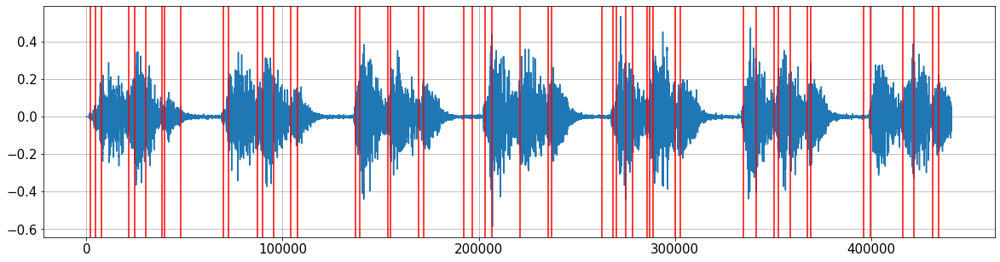

In [54]:
# применительно к нашим данным

plt.figure(figsize=(20, 5))
plt.plot(wavedata_librosa[:441000])

for x in onset_samples:
    plt.axvline(x=x, color='red', linewidth=1.5)
    
ax = plt.gca()
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15) 

plt.grid(True)
plt.show()

Ритмические признаки

In [55]:
hop_length = 512
oenv = librosa.onset.onset_strength(y=wavedata_librosa, 
                                    sr=samplerate, hop_length=hop_length) # onset в качестве потока
tempogram = librosa.feature.tempogram(y=wavedata_librosa, onset_envelope=oenv,
                                      sr=samplerate, hop_length=hop_length) # темпограмма 

ac_global = librosa.autocorrelate(oenv, max_size=tempogram.shape[0]) # автокорреляция onset 
ac_global = librosa.util.normalize(ac_global) # нормализуем

tempo = librosa.beat.tempo(onset_envelope=oenv, sr=samplerate, hop_length=hop_length)[0] # считаем темп onset

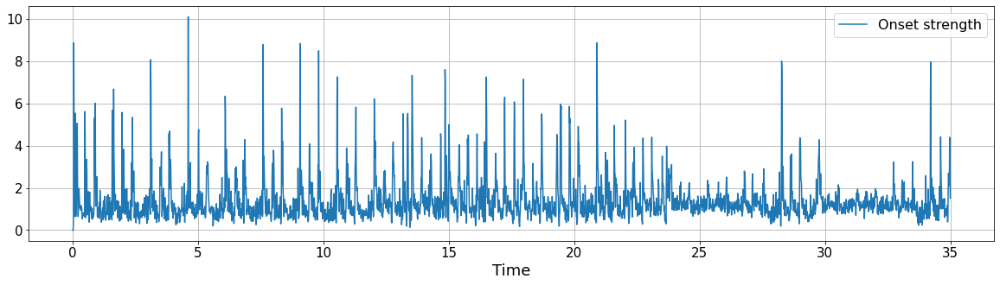

In [56]:
times = librosa.times_like(oenv, sr=samplerate, hop_length=hop_length)

plt.figure(figsize=(20, 5))
plt.plot(times, oenv, label='Onset strength')
plt.grid(True)
plt.legend(prop={'size':16})

ax = plt.gca()
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15) 

plt.xlabel('Time', fontsize=18)

plt.show()

/Users/aleksey_ryabykh/anaconda3/lib/python3.6/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'basey' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)


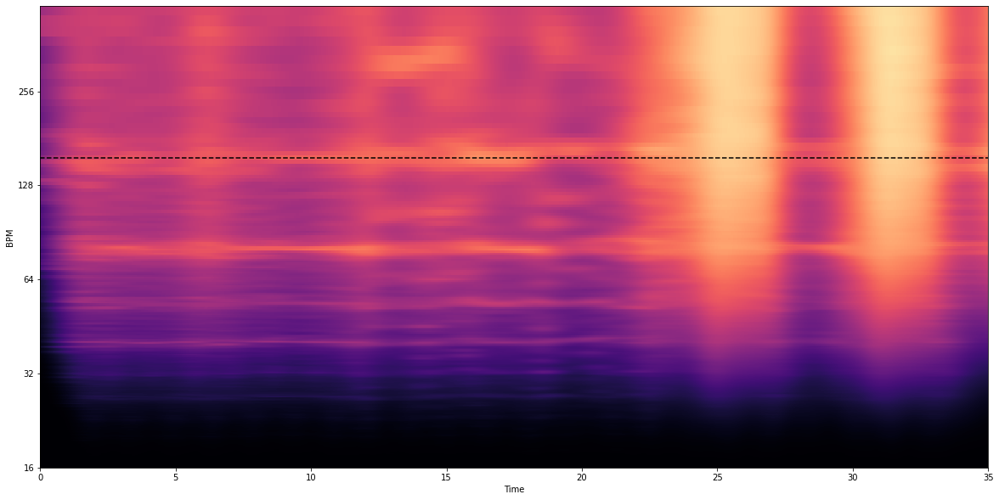

In [57]:
plt.figure(figsize=(20, 10))

librosa.display.specshow(tempogram, sr=samplerate, hop_length=hop_length, 
                         x_axis='time', y_axis='tempo')

plt.axhline(tempo, color='black', linestyle='--', alpha=1)
plt.show()

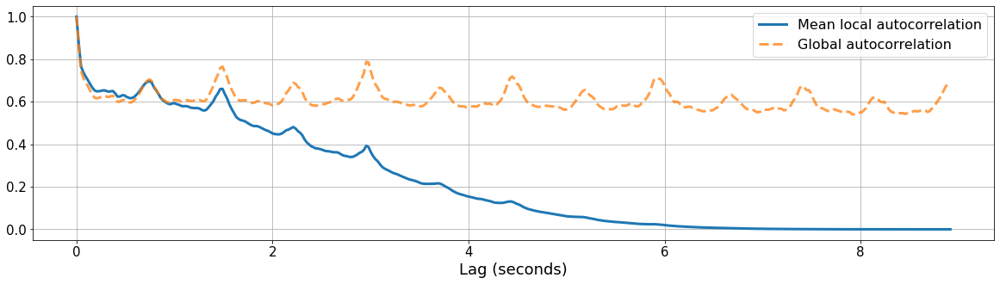

In [58]:
x = np.linspace(0, tempogram.shape[0] * float(hop_length) / sr, num=tempogram.shape[0])

plt.figure(figsize=(20, 5))
plt.plot(x, np.mean(tempogram, axis=1), lw=3, label='Mean local autocorrelation')
plt.plot(x, ac_global, '--', alpha=0.75, lw=3, label='Global autocorrelation')

ax = plt.gca()
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15) 

plt.xlabel('Lag (seconds)', fontsize=18)
plt.grid(True)
plt.legend(prop={'size':16})

plt.show()

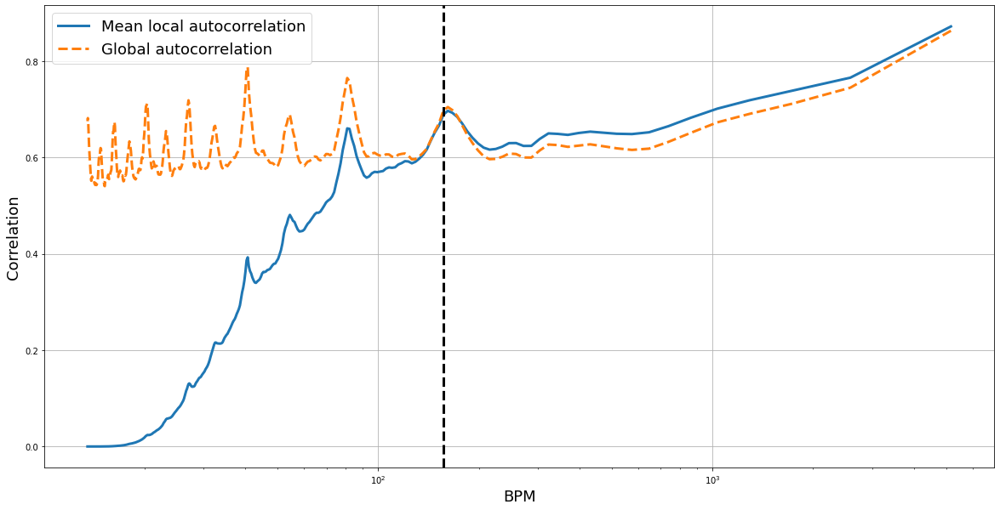

In [59]:
freqs = librosa.tempo_frequencies(tempogram.shape[0], hop_length=hop_length, sr=samplerate) # аналог спектра

plt.figure(figsize=(20, 10))
plt.semilogx(freqs[1:], np.mean(tempogram[1:], axis=1), lw=3, label='Mean local autocorrelation')
plt.semilogx(freqs[1:], ac_global[1:], '--', lw=3, label='Global autocorrelation')
plt.axvline(tempo, color='black', linestyle='--', lw=3)

plt.ylabel('Correlation', fontsize=18)
plt.xlabel('BPM', fontsize=18)

plt.legend(prop={'size':18})
plt.grid(True)
plt.show()

In [ ]:
# https://github.com/stevetjoa/musicinformationretrieval.com - больше примеров
# https://librosa.org/doc/latest/index.html